# **CDK1–APC Two-ODE System with Coupled Feedback**
## ***Differential Equations***

                                                    
$$
\frac{d(\text{CDK1}^*)}{dt} = \alpha_1 - \beta_1  CDK1^*\left( \frac{(\text{APC}^*)^{n_1}}{K_1^{n_1} + (\text{APC}^*)^{n_1}} \right)  +  \alpha_3\cdot(1-\text{CDK1}^*)  \left(\frac{(\text{CDK1}^*)^{n_3}}{K_3^{n_3} + (\text{CDK1}^*)^{n_3}} \right)
$$

$$
\frac{d(\text{APC}^*)}{dt} = \alpha_2 (1 - \text{APC}^*) \left( \frac{(\text{CDK1}^*)^{n_2}}{K_2^{n_2} + (\text{CDK1}^*)^{n_2}} \right) - \beta_2 \text{APC}^*
$$
                                                                                  

## ***Parameters***
- $\alpha_1 = 0.2$
- $\alpha_2 = 3$
- $\alpha_3 = 3$
- $\beta_1 = 3$
- $\beta_2 = 1$
- $K_1 = 0.5$
- $K_2 = 0.5$                                                             
- $K_3 = 0.5$
- $n_1 = 8$
- $n_2 = 8$
- $n_3 = 8$



In [1]:
import os, sys
print(sys.version)
print("--"* 60)
# print("Python executable:", sys.executable)
# print("--"* 60)
# print("PATH:", os.environ["PATH"])

3.10.13 | packaged by conda-forge | (main, Dec 23 2023, 15:36:39) [GCC 12.3.0]
------------------------------------------------------------------------------------------------------------------------


In [2]:
os.environ["PATH"] = ("/home/alka23224/miniconda3/envs/implicit_sindy/bin:" + os.environ["PATH"])

In [3]:
# -------------------------------
# Current working directory
# -------------------------------
# print(os.listdir())
current_dir = os.getcwd()
print(f"Current working directory: {current_dir}")


Current working directory: /home/alka23224/7_Cell_Cycle_Modelling


In [4]:
# -------------------------------
plot_dir = os.path.join(current_dir, "Plots_3")
os.makedirs(plot_dir, exist_ok=True) 

In [5]:
# -----------------------------
# Import Necessary Libraries
# -----------------------------
import numpy as np
import pandas as pd
import pysindy as ps
import sympy as sp
from matplotlib import pyplot as plt
from sympy import symbols, Eq, solve, Matrix, N, simplify, nsimplify
from scipy.optimize import fsolve
import plotly
import plotly.express as px
from matplotlib.colors import Normalize
from mpl_toolkits.mplot3d import Axes3D
from scipy.integrate import odeint
from pysindy.differentiation import FiniteDifference
from pysindy.optimizers.sindy_pi import SINDyPI
from sklearn.metrics import mean_squared_error, r2_score
from tqdm import tqdm
from tqdm.auto import tqdm
from IPython.display import display
from IPython.display import Image

In [6]:
# Created modules
from plot_utils import set_plot_style, set_spines_black
from network_utils import* 
from symbolic_model_utils import*
from sindypi_functions import*
from implicit_to_explicit import*
from steady_states_utils import*
# Apply global style 
set_plot_style(dpi=300)

In [7]:
# -------------------------------------------
# Define symbolic variable and parameters
# -------------------------------------------
x1, x2 = sp.symbols('x1 x2')

alpha1, alpha2, alpha3 = 0.2, 3, 3
beta1, beta2 = 3, 1
K1,K3 = 0.5, 0.5
n1, n2, n3 = 8, 8, 8
# Define the system of ODEs
dx1_dt = alpha1- beta1*x1*(x2**n1/(K1**n1 + x2**n1))+ alpha3*(1 - x1)*(x1**n3/(K3**n3 + x1**n3))
dx2_dt = alpha2*(1 - x2)*( x1**n2/(K3**n2 + x1**n2))- beta2*x2
# Display the ODEs
print("The two dimensional ODEs are:")
print("dx1/dt =", dx1_dt)
print("dx2/dt =", dx2_dt)

The two dimensional ODEs are:
dx1/dt = x1**8*(3 - 3*x1)/(x1**8 + 0.00390625) - 3*x1*x2**8/(x2**8 + 0.00390625) + 0.2
dx2/dt = x1**8*(3 - 3*x2)/(x1**8 + 0.00390625) - x2


In [8]:
# Rewrite dx1_dt and dx2_dt as a pure rational
num_dx1, den_dx1 = rational_simplify(dx1_dt, expand_denominator=True)
num_dx2, den_dx2 = rational_simplify(dx2_dt, expand_denominator=True)

# Display results
print("dx1_dt as a single rational function with:")
print("  Numerator:", num_dx1)
print("  Denominator:", den_dx1)
print("_"* 60)
print("dx2_dt as a single rational function with:")
print("  Numerator:", num_dx2)
print("  Denominator:", den_dx2)

dx1_dt as a single rational function with:
  Numerator: -6.0*x1**9*x2**8 - 0.01171875*x1**9 + 3.2*x1**8*x2**8 + 0.0125*x1**8 - 0.01171875*x1*x2**8 + 0.00078125*x2**8 + 3.0517578125e-6
  Denominator: 1.0*x1**8*x2**8 + 0.00390625*x1**8 + 0.00390625*x2**8 + 1.52587890625e-5
____________________________________________________________
dx2_dt as a single rational function with:
  Numerator: -4.0*x1**8*x2 + 3.0*x1**8 - 0.00390625*x2
  Denominator: 1.0*x1**8 + 0.00390625


In [9]:
# For x1: Highest degree monomial in the denominator is :x1**8*x2**8
# For x2: Highest degree monomial in the denominator is  :x1**8

In [10]:
###################################################################################################################################################
#                                  I.  Find the steady states  and Jacobian for 'THE ORIGINAL SYSTEM' and draw the local network
#
####################################################################################################################################################

In [11]:
# Now, to find steady states
def ss_func(vars):
    x1, x2 = vars
    dx1_dt = alpha1 - beta1*x1*(x2**n1/(K1**n1 + x2**n1)) + alpha3*(1 - x1)*(x1**n3/(K3**n3 + x1**n3))
    dx2_dt = alpha2*(1 - x2)*(x1**n2/(K3**n2 + x1**n2)) - beta2*x2
    return [dx1_dt, dx2_dt]

ss = find_steady_states(
    ss_func,
    num_vars=2,
    num_samples=500,
    tol=1e-8,
    domain=None,
)


print("Steady states found numerically:")
for s in ss:
    x1_ss, x2_ss = s
    print(f"[{x1_ss:.3f}, {x2_ss:.3f}]")

Steady states found numerically:
[0.463, 0.513]


In [12]:
# ------------------------------
# Define the Jacobian matrix of the system
# ------------------------------
vars = Matrix([x1, x2])
f = Matrix([dx1_dt, dx2_dt])
J = f.jacobian(vars).applyfunc(lambda expr: expr.evalf(3))

print("\nJacobian matrix:")
display(J)


Jacobian matrix:


Matrix([
[-8.0*x1**15*(3.0 - 3.0*x1)/(x1**8 + 0.00391)**2 - 3.0*x1**8/(x1**8 + 0.00391) + 8.0*x1**7*(3.0 - 3.0*x1)/(x1**8 + 0.00391) - 3.0*x2**8/(x2**8 + 0.00391), 24.0*x1*x2**15/(x2**8 + 0.00391)**2 - 24.0*x1*x2**7/(x2**8 + 0.00391)],
[                                                            -8.0*x1**15*(3.0 - 3.0*x2)/(x1**8 + 0.00391)**2 + 8.0*x1**7*(3.0 - 3.0*x2)/(x1**8 + 0.00391),                                    -3.0*x1**8/(x1**8 + 0.00391) - 1.0]])

In [13]:
# ------------------------------------------------------------------
#  Evaluate Jacobian and eigenvalues at each steady state
# ------------------------------------------------------------------
J_at_ss = []

for i, s in enumerate(ss, 1):
    # Substitution dictionary for the steady state
    subs_dict = {x1: s[0], x2: s[1]} 
    
    # Substitute into symbolic Jacobian
    J_sub = J.subs(subs_dict)
    
    # Compute symbolic eigenvalues 
    eigs = J_sub.eigenvals()
    J_eval = J_sub.evalf(3)
    J_at_ss.append(J_eval)

    # Print Jacobian
    coord_str = f"{float(s[0]):.3f}, {float(s[1]):.3f}"
    print(f"\nJacobian at SS {i} = ({coord_str}):")
    sp.pprint(J_eval)

    # Print eigenvalues
    print(f"Eigenvalues at SS {i}:")
    for ev, mult in eigs.items():
        print(f"  {ev.evalf(3)}  (×{mult})")



Jacobian at SS 1 = (0.463, 0.513):
⎡3.63  -5.36⎤
⎢           ⎥
⎣5.75  -2.05⎦
Eigenvalues at SS 1:
  0.79 - 4.77*I  (×1)
  0.79 + 4.77*I  (×1)



Interaction network near SS 1 = (0.463, 0.513):


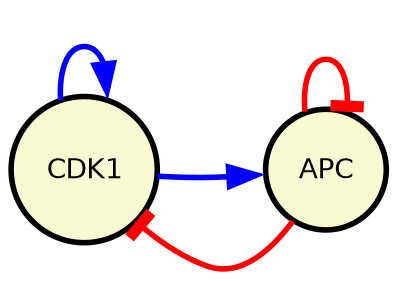

In [14]:
# Draw the network
nodes = ["CDK1", "APC"]
# ----------------------------------
#  Visualize interaction networks 
# ----------------------------------
try:
    Jacobians_np = [np.array(J_ss.tolist(), dtype=float) for J_ss in J_at_ss]
    for i, (J_np, ss_point) in enumerate(zip(Jacobians_np, ss), 1):
        output_path = f"Plots_3/CDK1_APC_PF_network_{i}"
        graph = draw_network(
            J_np,
            nodes=nodes,
            output_path=output_path,
            label_fontsize=10,
            graph_size='10,10',
            dpi=200
        )

        coord_str = ', '.join(f"{N(v, 3)}" for v in ss_point)
        print(f"\nInteraction network near SS {i} = ({coord_str}):")
        display(Image(filename=output_path + '.png'))

except Exception as e:
    print(f" Can't  Draw the Network: {e}")

In [15]:
###################################################################################################################################################
#                                                II. Training Implicit SINDy (SINDy- PI)
#
####################################################################################################################################################


The shape of the Training Data is: (1001, 2)


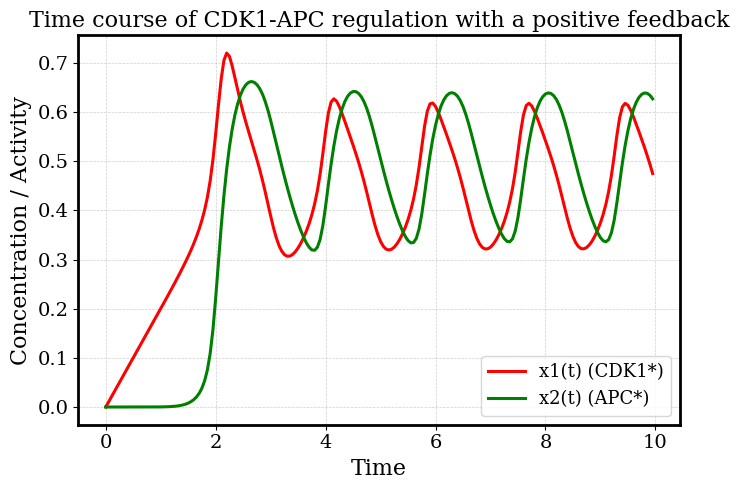

In [16]:
# -------------------------------
#  Generate the Training Data
# --------------------------------
# Define the System of ODEs, x1 = CDK1*, x2 = APC*
def two_dim(x, t):
    x1, x2 = x
    dx1_dt = alpha1- beta1*x1*(x2**n1/(K1**n1 + x2**n1))+ alpha3*(1 - x1)*(x1**n3/(K3**n3 + x1**n3))
    dx2_dt = alpha2*(1 - x2)*( x1**n2/(K3**n2 + x1**n2))- beta2*x2
    return [dx1_dt, dx2_dt]
    

# Initial conditions
x0 = [0.0, 0.0]
## Time points for the simulation
dt = 0.05
t0 = 0
tf= 50
t = np.arange(t0, tf + dt, dt)
## Solve the ODEs
x_train  = odeint(two_dim, x0, t)
print(f'\nThe shape of the Training Data is: {x_train.shape}')
## Time series plot
fig, ax = plt.subplots(figsize=(7, 5), dpi=100)
# Plot x1(t)
ax.plot(t[:200], x_train[:200, 0], 'r-', label='x1(t) (CDK1*)')

# Plot x2(t)
ax.plot(t[:200], x_train[:200, 1], 'g-', label='x2(t) (APC*)')
# Labels, title, legend, grid
ax.grid(True, which='both', ls='--', lw=0.5)
ax.set_xlabel('Time')
ax.set_ylabel('Concentration / Activity')
ax.set_title('Time course of CDK1-APC regulation with a positive feedback')
# Legend 
ax.legend()
# Thick black spines 
set_spines_black(ax)
plt.tight_layout()
plt.savefig("Plots_3/TimeSeries_CDK1_APC_PF.pdf", bbox_inches="tight")
plt.show()


In [17]:
# -----------------------------------
#  Create library : Theta(X, dot(X_k))
# -----------------------------------

# ***For x1 variable:***

In [18]:
library_x1 = [
    lambda x1, x2: x1**8,
    lambda x1, x2: x1**9,
    lambda x1, x2: x2**8,
    lambda x1, x2: x1*x2**8,
    lambda x1, x2: x1**8*x2**8,
    lambda x1, x2: x1**9*x2**8,
 ]

library_x1dot = [lambda x1, x2: x1]

library_name_x1 = [
    lambda x1, x2: x1 + x1 + x1 + x1 + x1 + x1 + x1 + x1,
    lambda x1, x2: x1 + x1 + x1 + x1 + x1 + x1 + x1 + x1 + x1,
    lambda x1, x2: x2 + x2 + x2 + x2 + x2 + x2 + x2 + x2,
    lambda x1, x2: x1 + x2 + x2 + x2 + x2 + x2 + x2 + x2 + x2,
    lambda x1, x2: x1 + x1 + x1 + x1 + x1 + x1 + x1 + x1 + x2 + x2 + x2 + x2 + x2 + x2 + x2 + x2,
    lambda x1, x2: x1 + x1 + x1 + x1 + x1 + x1 + x1 + x1 + x1 + x2 + x2 + x2 + x2 + x2 + x2 + x2 + x2,
    lambda x1, x2: x1]

theta_x1 = ps.SINDyPILibrary(
        library_functions=library_x1,
        x_dot_library_functions=library_x1dot,
        t=t,
        function_names=library_name_x1,
        include_bias=True,
    )
# Explicitly fit the library to the training data
theta_x1.fit(x_train)
    
# Print feature names as in original code
print("Candidates in the library for x1 are:")
print(get_reformatted_feature_names(theta_x1.get_feature_names()))
print("-"* 60)
print(f"and Total number of Candidates in the library is: {len(theta_x1.get_feature_names())}")

Candidates in the library for x1 are:
['1', 'x0**8', 'x0**9', 'x1**8', 'x0*x1**8', 'x0**8*x1**8', 'x0**9*x1**8', 'x0_dot', 'x0**8*x0_dot', 'x0**9*x0_dot', 'x0_dot*x1**8', 'x0*x0_dot*x1**8', 'x0**8*x0_dot*x1**8', 'x0**9*x0_dot*x1**8']
------------------------------------------------------------
and Total number of Candidates in the library is: 14


# ***For x2 variable:***

In [19]:
library_x2 = [
    lambda x1, x2: x2,
    lambda x1, x2: x1**8,
    lambda x1, x2: x1**8*x2]

library_x2dot = [lambda x1, x2: x2]
library_name_x2 =  [
    lambda x1, x2: x2,
    lambda x1, x2: x1 + x1 + x1 + x1 + x1 + x1 + x1 + x1,
    lambda x1, x2: x1 + x1 + x1 + x1 + x1 + x1 + x1 + x1 + x2,
    lambda x1, x2: x2]
theta_x2 = ps.SINDyPILibrary(
        library_functions=library_x2,
        x_dot_library_functions=library_x2dot,
        t=t,
        function_names=library_name_x2,
        include_bias=False,
    )
# Explicitly fit the library to the training data
theta_x2.fit(x_train)
    
# Print feature names as in original code
print("Candidates in the library for x2 are:")
print(get_reformatted_feature_names(theta_x2.get_feature_names()))
print("-"* 60)
print(f"and Total number of Candidates in the library is: {len(theta_x2.get_feature_names())}")

Candidates in the library for x2 are:
['x1', 'x0**8', 'x0**8*x1', 'x1_dot', 'x1*x1_dot', 'x0**8*x1_dot', 'x0**8*x1*x1_dot']
------------------------------------------------------------
and Total number of Candidates in the library is: 7


# ***For x1 variable:***

In [20]:
# Define threshold
threshold_values=np.logspace(-15, -4, 25)
feature_names = ["x1", "x2"]
# Perform grid search
mses_1, rel_errs_1, nonzeros_1, aics_1, bics_1, best_threshold_1 = optimize_threshold(
    library=theta_x1,
    x_train=x_train,
    t=t,
    threshold_values=threshold_values,
    feature_names= feature_names
)

Threshold grid search:   0%|          | 0/25 [00:00<?, ?it/s]

Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Solver failed on model  1 , setting coefs to zeros
Model  2
Solver failed on model  2 , setting coefs to zeros
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Solver failed on model  4 , setting coefs to zeros
Model  5
Model  6
Model  7
Solver failed on model  7 , setting coefs to zeros
Model  8
Solver failed on model  8 , setting coefs to zeros
Model  9
Model  10
Solver failed on model  10 , setting coefs to zeros
Model  11
Solver failed on model  11 , setting coefs to zeros
Model  12
Model  13
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Solver failed on model  1 , setting coefs to zeros
Model  2
Solver failed on model  2 , setting coefs to zeros
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Solver failed on model  4 , setting coefs to zeros
Model  5
Model  6
Model  7
Solver failed on model  7 , setting coefs to zeros
Model  8
Solver failed on model

/home/alka23224/miniconda3/envs/implicit_sindy/lib/python3.10/site-packages/cvxpy/problems/problem.py:1504: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Model  6
Model  7
Solver failed on model  7 , setting coefs to zeros
Model  8
Solver failed on model  8 , setting coefs to zeros
Model  9
Model  10
Solver failed on model  10 , setting coefs to zeros
Model  11
Solver failed on model  11 , setting coefs to zeros
Model  12
Model  13
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Solver failed on model  1 , setting coefs to zeros
Model  2
Solver failed on model  2 , setting coefs to zeros
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Solver failed on model  4 , setting coefs to zeros
Model  5
Model  6
Model  7
Solver failed on model  7 , setting coefs to zeros
Model  8
Solver failed on model  8 , setting coefs to zeros
Model  9
Model  10
Solver failed on model  10 , setting coefs to zeros
Model  11


/home/alka23224/miniconda3/envs/implicit_sindy/lib/python3.10/site-packages/cvxpy/problems/problem.py:1504: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Model  12
Model  13
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Solver failed on model  1 , setting coefs to zeros
Model  2
Solver failed on model  2 , setting coefs to zeros
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Solver failed on model  4 , setting coefs to zeros
Model  5
Model  6
Model  7
Solver failed on model  7 , setting coefs to zeros
Model  8
Solver failed on model  8 , setting coefs to zeros
Model  9
Model  10
Solver failed on model  10 , setting coefs to zeros
Model  11


/home/alka23224/miniconda3/envs/implicit_sindy/lib/python3.10/site-packages/cvxpy/problems/problem.py:1504: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Model  12
Model  13
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Solver failed on model  1 , setting coefs to zeros
Model  2
Solver failed on model  2 , setting coefs to zeros
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Model  5
Model  6
Model  7
Solver failed on model  7 , setting coefs to zeros
Model  8
Solver failed on model  8 , setting coefs to zeros
Model  9
Model  10


/home/alka23224/miniconda3/envs/implicit_sindy/lib/python3.10/site-packages/cvxpy/problems/problem.py:1504: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Model  11
Model  12
Model  13
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Solver failed on model  1 , setting coefs to zeros
Model  2
Solver failed on model  2 , setting coefs to zeros
Model  3
Model  4
Model  5
Model  6
Model  7
Solver failed on model  7 , setting coefs to zeros
Model  8


/home/alka23224/miniconda3/envs/implicit_sindy/lib/python3.10/site-packages/cvxpy/problems/problem.py:1504: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Model  9
Model  10
Model  11
Model  12
Model  13
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Model  4
Model  5
Model  6
Model  7
Solver failed on model  7 , setting coefs to zeros
Model  8
Model  9
Model  10
Model  11
Model  12
Model  13
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Model  4
Model  5
Model  6
Model  7
Solver failed on model  7 , setting coefs to zeros
Model  8
Model  9
Model  10
Model  11
Model  12
Model  13
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Model  4
Model  5
Model  6
Model  7
Solver failed on model  7 , setting coefs to zeros
Model  8
Model  9
Model  10
Model  11
Model  12
Model  13
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Model  4
Model  5
Model  6
Model  7
Solver failed on model  7 , setting coefs to zeros
Model  8
Model  9
Model  10
Model  11
Model  12
Model  13
Model  0
Solver failed 

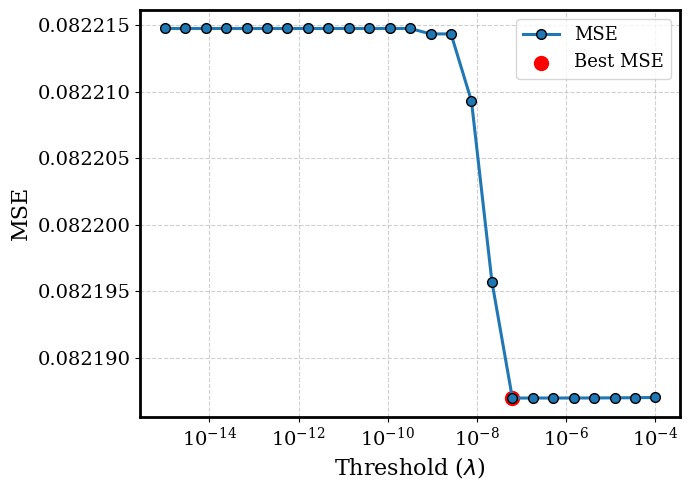

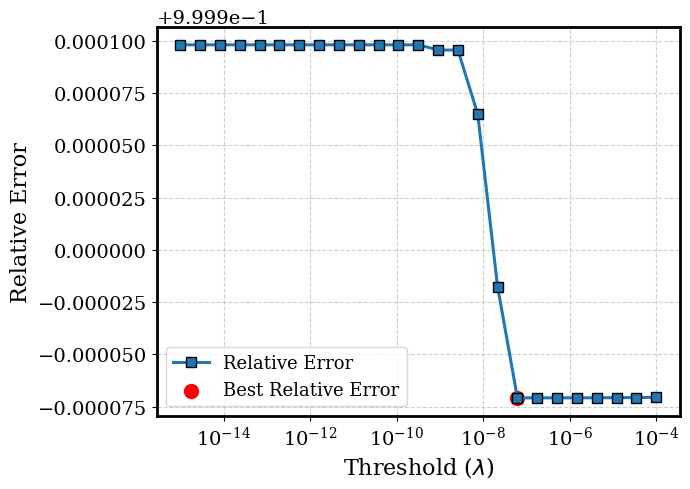

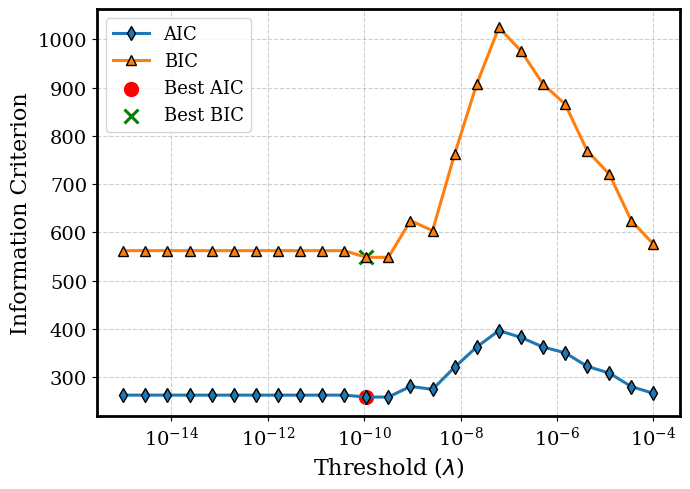

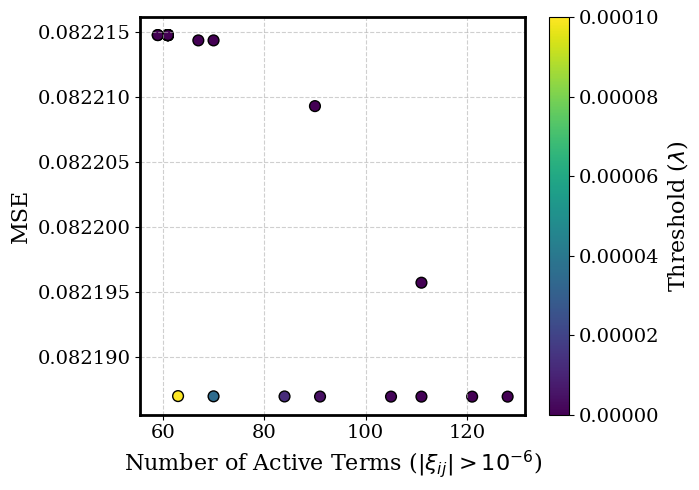

In [21]:
# Plot the results
plot_threshold_diagnostics(threshold_values,mses_1,rel_errs_1,aics_1,bics_1,nonzeros_1,dpi=100)


In [22]:
# Populate the result into table
table_best_thresholds(threshold_values, mses_1, rel_errs_1, aics_1, bics_1)



Best Thresholds for each metric:
Best Threshold (based on MSE)         : 6.19e-08
Best Threshold (based on Relative Error) : 6.19e-08
Best Threshold (based on AIC)         : 1.101e-10
Best Threshold (based on BIC)         : 1.101e-10



In [23]:
########################################### CASE 1--- best_threshold=6.19e-08 ################################################

In [24]:
features_x1_c1, coefficients_x1_c1, per_eq_results_1_c1 = evaluate_model_per_equation(
    library = theta_x1,
    x_train= x_train,
    t = t,
    best_threshold=6.19e-08,
    feature_names =["x1", "x2"]
)


Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Model  4
Model  5
Model  6
Model  7
Solver failed on model  7 , setting coefs to zeros
Model  8
Model  9
Model  10
Model  11
Model  12
Model  13

Models sorted by lowest Relative Error (lambda=6.19e-08):


,Eq,Feature,R Square,Relative Error,AIC,BIC,Active Terms (Implicit Equation)
4,4,x1*x2**8,0.9999,7.1665e-03,-19811.6642,-19757.6679,11
3,3,x2**8,0.9999,7.4142e-03,-18435.6180,-18381.6217,11
11,11,x1*x1_dot*x2**8,0.9998,1.1182e-02,-21058.6466,-21009.5590,10
10,10,x1_dot*x2**8,0.9998,1.1675e-02,-19607.4946,-19553.4983,11
1,1,x1**8,0.9997,1.5153e-02,-17709.0899,-17655.0936,11
2,2,x1**9,0.9995,1.9418e-02,-18161.5419,-18107.5456,11
8,8,x1**8*x1_dot,0.9989,3.2599e-02,-18228.7339,-18174.7376,11
9,9,x1**9*x1_dot,0.9986,3.6987e-02,-18944.9832,-18890.9869,11
6,6,x1**9*x2**8,0.9968,4.8255e-02,-25241.6507,-25187.6544,11
5,5,x1**8*x2**8,0.9951,5.9080e-02,-23770.1369,-23716.1406,11


In [25]:
#####################################################################################################################################################
#                                               IIIa.  CASE 1  Implicit to explicit conversion for x_1
#
#####################################################################################################################################################

In [26]:
left_coeff_x1_c1 = generate_identity_matrix(features_x1_c1)
right_coeff_x1_c1 = coefficients_x1_c1
eq_list_x1_c1, token_symbols_x1_c1 = generate_symbolic_equations_both_sides(
    features_x1_c1,
    left_coeff_x1_c1,
    right_coeff_x1_c1
)


In [27]:
# Print the models
raw_x1_c1, rescaled_x1_c1, cleaned_x1_c1, final_model_x1_c1 = print_and_store_models(
    eq_list=eq_list_x1_c1,
    xdot_symbol=token_symbols_x1_c1['x1_dot'],
    target=x1**8*x2**8,
    gens=(x1,x2),
    sig_digits=4,
    tol=1e-6, 
    latex_path="Examples_Related/Ex_3_latex_x1_c1.txt",
    csv_path="Examples_Related/Ex_3_x1_c1.csv"
)


Model 0: No solution.
Model 1:
          -2.295*x1**9*x2**8 - 0.08098*x1**9 + 0.06309*x1**8 - 0.01106*x1*x2**8 - 0.003461*x2**8 + 1.074e-5
x1_dot = -------------------------------------------------------------------------------------------------
          -0.04299*x1**9 + 1.0*x1**8*x2**8 + 0.03552*x1**8 + 0.1518*x1*x2**8 - 0.05597*x2**8 + 6.066e-5
[Terms: numerator=6, denominator=6]
Model 2:
          -5.983*x1**9*x2**8 - 0.3003*x1**9 + 0.2289*x1**8 - 0.1342*x1*x2**8 + 0.02987*x2**8 + 2.44e-5
x1_dot = --------------------------------------------------------------------------------------------
          -0.1524*x1**9 + 1.0*x1**8*x2**8 + 0.1234*x1**8 + 0.7479*x1*x2**8 - 0.2872*x2**8 + 0.0001904
[Terms: numerator=6, denominator=6]
Model 3:
          0.001657*x1**9 - 0.7945*x1**8*x2**8 + 0.0002404*x1**8 + 0.08963*x1*x2**8 - 0.04579*x2**8 + 2.217e-5
x1_dot = ---------------------------------------------------------------------------------------------------
          0.02252*x1**9 + 1.0*x1**

This case did not produced any interpretable model, as all the terms in the denominator has at least one negative term.

In [28]:
########################################### CASE 2 ################################################

In [29]:
features_x1_c2, coefficients_x1_c2, per_eq_results_1_c2 = evaluate_model_per_equation(
    library = theta_x1,
    x_train= x_train,
    t = t,
    best_threshold=1.101e-10,
    feature_names =["x1", "x2"]
)


Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Solver failed on model  1 , setting coefs to zeros
Model  2
Solver failed on model  2 , setting coefs to zeros
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Solver failed on model  4 , setting coefs to zeros
Model  5
Model  6
Model  7
Solver failed on model  7 , setting coefs to zeros
Model  8
Solver failed on model  8 , setting coefs to zeros
Model  9
Model  10
Solver failed on model  10 , setting coefs to zeros
Model  11
Solver failed on model  11 , setting coefs to zeros
Model  12
Model  13

Models sorted by lowest Relative Error (lambda=1.101e-10):


,Eq,Feature,R Square,Relative Error,AIC,BIC,Active Terms (Implicit Equation)
6,6,x1**9*x2**8,1.0000,1.1380e-03,-32741.6604,-32682.7554,12
5,5,x1**8*x2**8,1.0000,1.1460e-03,-31661.2966,-31602.3915,12
12,12,x1**8*x1_dot*x2**8,1.0000,3.8943e-03,-31536.6477,-31477.7426,12
13,13,x1**9*x1_dot*x2**8,1.0000,5.1719e-03,-32031.3352,-31982.2476,10
9,9,x1**9*x1_dot,0.9987,3.5893e-02,-19001.0881,-18937.2742,13
11,11,x1*x1_dot*x2**8,-0.4818,1.0000e+00,-12082.8383,-12082.8383,0
8,8,x1**8*x1_dot,-0.0001,1.0000e+00,-11396.9545,-11396.9545,0
10,10,x1_dot*x2**8,-0.5124,1.0000e+00,-10719.9979,-10719.9979,0
2,2,x1**9,-0.3787,1.0000e+00,-10292.5776,-10292.5776,0
4,4,x1*x2**8,-0.7152,1.0000e+00,-9947.1085,-9947.1085,0


In [30]:
#####################################################################################################################################################
#                                               IIIa.  CASE 2  Implicit to explicit conversion for x_1
#
#####################################################################################################################################################

In [31]:
left_coeff_x1_c2 = generate_identity_matrix(features_x1_c2)
right_coeff_x1_c2 = coefficients_x1_c2
eq_list_x1_c2, token_symbols_x1_c2 = generate_symbolic_equations_both_sides(
    features_x1_c2,
    left_coeff_x1_c2,
    right_coeff_x1_c2
)


In [32]:
# Print the models
raw_x1_c2, rescaled_x1_c2, cleaned_x1_c2, final_model_x1_c2 = print_and_store_models(
    eq_list=eq_list_x1_c2,
    xdot_symbol=token_symbols_x1_c2['x1_dot'],
    target=x1**8*x2**8,
    gens=(x1,x2),
    sig_digits=4,
    tol=1e-6, 
    latex_path="Examples_Related/Ex_3_latex_x1_c2.txt",
    csv_path="Examples_Related/Ex_3_x1_c2.csv"
)


Model 0: No solution.
Model 1: No solution.
Model 2: No solution.
Model 3: No solution.
Model 4: No solution.
Model 5:
          -18.45*x1**9*x2**8 - 0.03101*x1**9 + 10.05*x1**8*x2**8 + 0.03487*x1**8 - 0.04254*x1*x2**8 + 0.005333*x2**8 + 8.429e-6
x1_dot = ---------------------------------------------------------------------------------------------------------------------
          2.459*x1**9*x2**8 + 0.001347*x1**9 + 1.0*x1**8*x2**8 + 0.01197*x1**8 + 0.01837*x1*x2**8 + 0.005259*x2**8 + 4.153e-5
[Terms: numerator=7, denominator=7]
Model 6:
          -7.338*x1**9*x2**8 - 0.01336*x1**9 + 3.96*x1**8*x2**8 + 0.01476*x1**8 - 0.01667*x1*x2**8 + 0.001956*x2**8 + 3.366e-6
x1_dot = -----------------------------------------------------------------------------------------------------------------------
          0.1632*x1**9*x2**8 + 0.0005767*x1**9 + 1.0*x1**8*x2**8 + 0.004951*x1**8 + 0.003671*x1*x2**8 + 0.003462*x2**8 + 1.716e-5
[Terms: numerator=7, denominator=7]
Model 7: Solver failed (zero nume

In [33]:
# Model 5, 6 has non negative term in the denominator.

In [34]:
# dx1_dt as a single rational function with:
#   Numerator: -6.0*x1**9*x2**8 - 0.01171875*x1**9 + 4.5*x1**8*x2**8 + 0.017578125*x1**8 - 0.01171875*x1*x2**8 + 0.005859375*x2**8 + 2.288818359375e-5
#   Denominator: 1.0*x1**8*x2**8 + 0.00390625*x1**8 + 0.00390625*x2**8 + 1.52587890625e-5

In [35]:
#******************************************************************************************************************************************

# ***For x2 variable:***

In [36]:
# Perform grid search
# Define threshold
threshold_values=np.logspace(-6, -4, 20)
mses_2, rel_errs_2, nonzeros_2, aics_2, bics_2, best_threshold_2 = optimize_threshold(
    library=theta_x2,
    x_train=x_train,
    t=t,
    threshold_values=threshold_values,
    feature_names = ["x1", "x2"],
    show_progress = True   
)

Threshold grid search:   0%|          | 0/20 [00:00<?, ?it/s]

Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Model  5
Model  6
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Model  5
Model  6
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Model  5
Model  6
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Model  5
Model  6
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Model  5
Model  6
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Model  5
Model  6
Model  0
S

/home/alka23224/miniconda3/envs/implicit_sindy/lib/python3.10/site-packages/cvxpy/problems/problem.py:1504: UserWarning:

Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.



Model  4
Model  5
Model  6
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Model  5
Model  6
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Model  5
Model  6
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Model  5
Model  6
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Model  5
Model  6
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Model  5
Model  6
Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
M

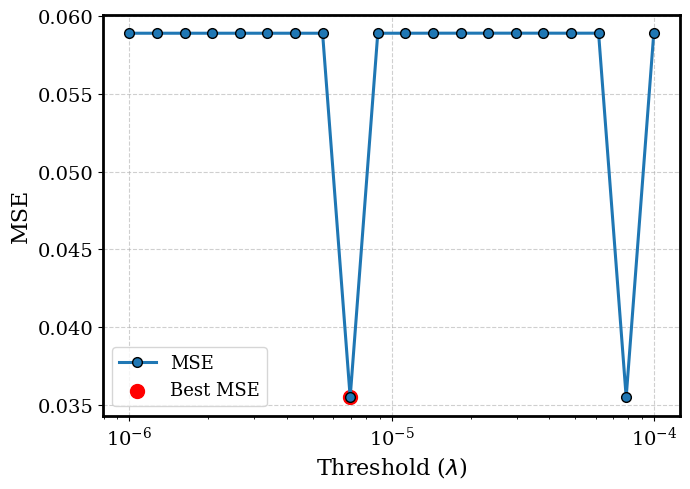

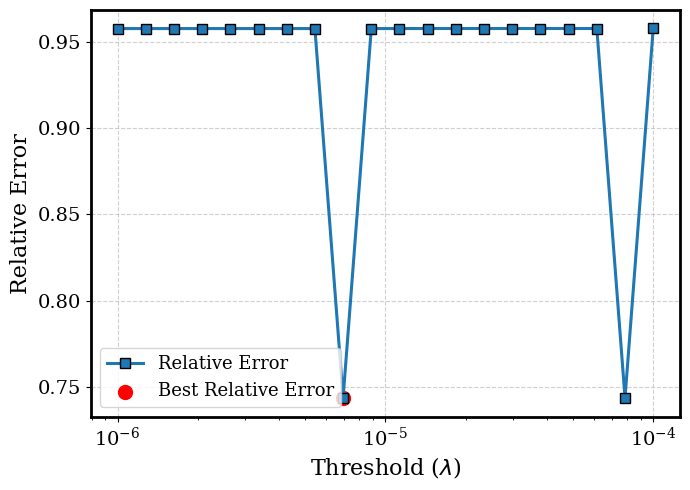

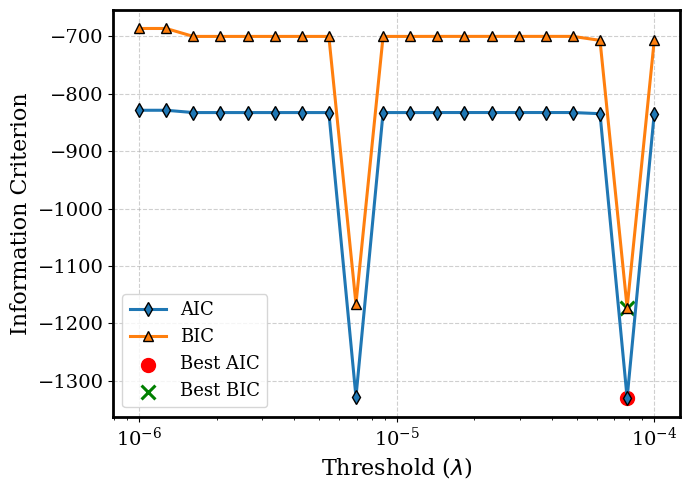

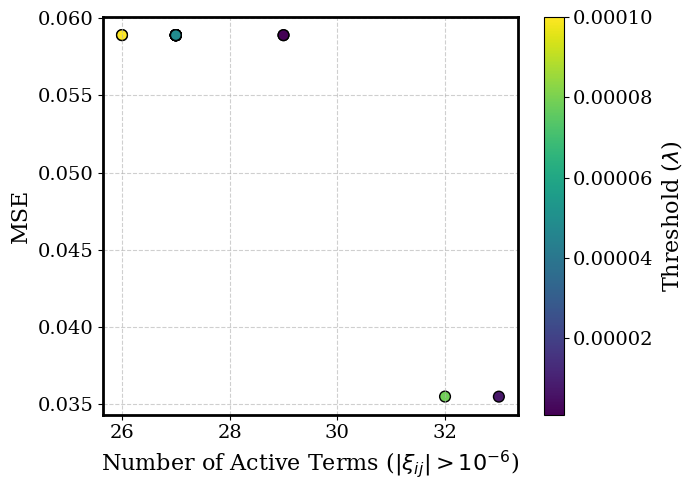

In [37]:
# Plot the results
plot_threshold_diagnostics(threshold_values,mses_2,rel_errs_2,aics_2,bics_2,nonzeros_2,dpi=100)

In [38]:
# Populate the result into table
table_best_thresholds(threshold_values, mses_2, rel_errs_2, aics_2, bics_2)



Best Thresholds for each metric:
Best Threshold (based on MSE)         : 6.952e-06
Best Threshold (based on Relative Error) : 6.952e-06
Best Threshold (based on AIC)         : 7.848e-05
Best Threshold (based on BIC)         : 7.848e-05



In [39]:
########################################### CASE 1-----best_threshold =6.952e-06, ################################################

In [40]:
features_x2, coefficients_x2, per_eq_results_2 = evaluate_model_per_equation(
    library = theta_x2,
    x_train= x_train,
    t = t,
    best_threshold =6.952e-06,
    feature_names =["x1", "x2"]
)


Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Model  4
Model  5
Model  6

Models sorted by lowest Relative Error (lambda=6.952e-06):


,Eq,Feature,R Square,Relative Error,AIC,BIC,Active Terms (Implicit Equation)
1,1,x1**8,1.0000,1.8218e-03,-21962.0830,-21937.5392,5
2,2,x1**8*x2,1.0000,2.6203e-03,-22465.7015,-22441.1578,5
5,5,x1**8*x2_dot,0.9999,8.4352e-03,-19661.4942,-19632.0417,6
3,3,x2_dot,0.9991,3.0605e-02,-8775.8209,-8741.4596,7
6,6,x1**8*x2*x2_dot,0.9934,7.4907e-02,-16710.1149,-16685.5711,5
4,4,x2*x2_dot,0.9834,1.2881e-01,-7374.9221,-7345.4695,6
0,0,x2,-11.1909,1.0000e+00,-1397.1732,-1397.1732,0


In [41]:
#####################################################################################################################################################
#                                               IIIb. CASE 1  Implicit to explicit conversion for x_2
#
#####################################################################################################################################################

In [42]:
left_coeff_x2 = generate_identity_matrix(features_x2)
right_coeff_x2 = coefficients_x2
eq_list_x2, token_symbols_x2 = generate_symbolic_equations_both_sides(
    features_x2, 
    left_coeff_x2,
    right_coeff_x2
)


In [43]:
# Print the models
raw_x2, rescaled_x2, cleaned_x2, final_model_x2 = print_and_store_models(
    eq_list=eq_list_x2,
    xdot_symbol=token_symbols_x2['x2_dot'],
    target=x1**8,
    gens=(x1,x2),
    sig_digits=4,
    tol=1e-6, 
    latex_path="Examples_Related/Ex_3_latex_x2_c1.txt",
    csv_path="Examples_Related/Ex_3_x2_c1.csv"
)


Model 0: No solution.
Model 1:
          -3.919*x1**8*x2 + 2.963*x1**8 - 0.004023*x2
x2_dot = -------------------------------------------
          1.0*x1**8 + 0.0004261*x2 + 0.003882
[Terms: numerator=3, denominator=3]
Model 2:
          -3.952*x1**8*x2 + 2.978*x1**8 - 0.003984*x2
x2_dot = -------------------------------------------
          1.0*x1**8 - 4.559e-6*x2 + 0.004059
[Terms: numerator=3, denominator=3]
Model 3:
          -3.878*x1**8*x2 + 2.922*x1**8 - 0.003912*x2
x2_dot = ----------------------------------------------------
          -0.0394*x1**8*x2 + 1.0*x1**8 + 5.25e-5*x2 + 0.003958
[Terms: numerator=3, denominator=4]
Model 4:
          -3.321*x1**8*x2 + 2.54*x1**8 - 0.00373*x2
x2_dot = ------------------------------------------------------
          -0.2884*x1**8*x2 + 1.0*x1**8 + 0.007514*x2 + 0.0002226
[Terms: numerator=3, denominator=4]
Model 5:
          -3.65*x1**8*x2 + 2.743*x1**8 - 0.003653*x2
x2_dot = ------------------------------------------------------
       

In [44]:
########################################### CASE 2 ################################################

In [45]:
features_x2_c2, coefficients_x2_c2, per_eq_results_2_c2 = evaluate_model_per_equation(
    library = theta_x2,
    x_train= x_train,
    t = t,
    best_threshold =7.848e-05,
    feature_names =["x1", "x2"]
)


Model  0
Solver failed on model  0 , setting coefs to zeros
Model  1
Model  2
Model  3
Solver failed on model  3 , setting coefs to zeros
Model  4
Model  5
Model  6

Models sorted by lowest Relative Error (lambda=7.848e-05):


,Eq,Feature,R Square,Relative Error,AIC,BIC,Active Terms (Implicit Equation)
1,1,x1**8,1.0000,2.7685e-03,-21124.2887,-21099.7450,5
2,2,x1**8*x2,0.9999,8.0569e-03,-20216.9568,-20192.4130,5
5,5,x1**8*x2_dot,0.9975,4.6571e-02,-16240.9165,-16211.4640,6
6,6,x1**8*x2*x2_dot,0.9934,7.4974e-02,-16708.3226,-16683.7788,5
4,4,x2*x2_dot,0.9824,1.3265e-01,-7318.1729,-7293.6292,5
3,3,x2_dot,-0.0009,1.0000e+00,-1809.6833,-1809.6833,0
0,0,x2,-11.1909,1.0000e+00,-1397.1732,-1397.1732,0


In [46]:
#####################################################################################################################################################
#                                               IIIb. CASE 2  Implicit to explicit conversion for x_2
#
#####################################################################################################################################################

In [47]:
left_coeff_x2_c2 = generate_identity_matrix(features_x2_c2)
right_coeff_x2_c2 = coefficients_x2_c2
eq_list_x2_c2, token_symbols_x2_c2 = generate_symbolic_equations_both_sides(
    features_x2_c2,
    left_coeff_x2_c2,
    right_coeff_x2_c2
)


In [48]:
# Print the models
raw_x2_c2, rescaled_x2_c2, cleaned_x2_c2, final_model_x2_c2 = print_and_store_models(
    eq_list=eq_list_x2_c2,
    xdot_symbol=token_symbols_x2_c2['x2_dot'],
    target=x1**8,
    gens=(x1,x2),
    sig_digits=4,
    tol=1e-6, 
    latex_path="Examples_Related/Ex_3_latex_x2_c2.txt",
    csv_path="Examples_Related/Ex_3_x2_c2.csv"
)


Model 0: No solution.
Model 1:
          -3.863*x1**8*x2 + 2.946*x1**8 - 0.004183*x2
x2_dot = -------------------------------------------
          1.0*x1**8 + 0.001671*x2 + 0.003457
[Terms: numerator=3, denominator=3]
Model 2:
          -4.244*x1**8*x2 + 3.119*x1**8 - 0.003734*x2
x2_dot = -------------------------------------------
          1.0*x1**8 - 0.00331*x2 + 0.005522
[Terms: numerator=3, denominator=3]
Model 3: Solver failed (zero numerator).
Model 4:
          0.2848*x1**8 - 0.002818*x2
x2_dot = ------------------------------------------------
          -1.743*x1**8*x2 + 1.0*x1**8 + 0.0536*x2 - 0.0226
[Terms: numerator=2, denominator=4]
Model 5:
          -1.962*x1**8*x2 + 1.398*x1**8 - 0.001603*x2
x2_dot = ----------------------------------------------------
          -1.188*x1**8*x2 + 1.0*x1**8 + 0.005518*x2 - 0.001002
[Terms: numerator=3, denominator=4]
Model 6:
          -0.3065*x1**8 + 0.001552*x2
x2_dot = --------------------------------------------------
          -2.7

In [49]:
# In both cases, Model 1 is the only model, which is free from negative denominator.

In [50]:
# dx2_dt as a single rational function with:
#   Numerator: -4.0*x1**8*x2 + 3.0*x1**8 - 0.00390625*x2
#   Denominator: 1.0*x1**8 + 0.00390625


In [51]:
# Model 1: 5,6 CASE 2
# Model 2: 1 From any CASE

In [52]:
#####################################################################################################################################################
#                                                   IV. Select a model and simulate it.
#
#####################################################################################################################################################


==== MODEL : For x1: 5 and for x2: 1 ====
x1_dot = (-18.45*x1**9*x2**8 - 0.03101*x1**9 + 10.05*x1**8*x2**8 + 0.03487*x1**8 - 0.04254*x1*x2**8 + 0.005333*x2**8 + 8.429e-6)/(2.459*x1**9*x2**8 + 0.001347*x1**9 + 1.0*x1**8*x2**8 + 0.01197*x1**8 + 0.01837*x1*x2**8 + 0.005259*x2**8 + 4.153e-5)
x2_dot = (-3.919*x1**8*x2 + 2.963*x1**8 - 0.004023*x2)/(1.0*x1**8 + 0.0004261*x2 + 0.003882)


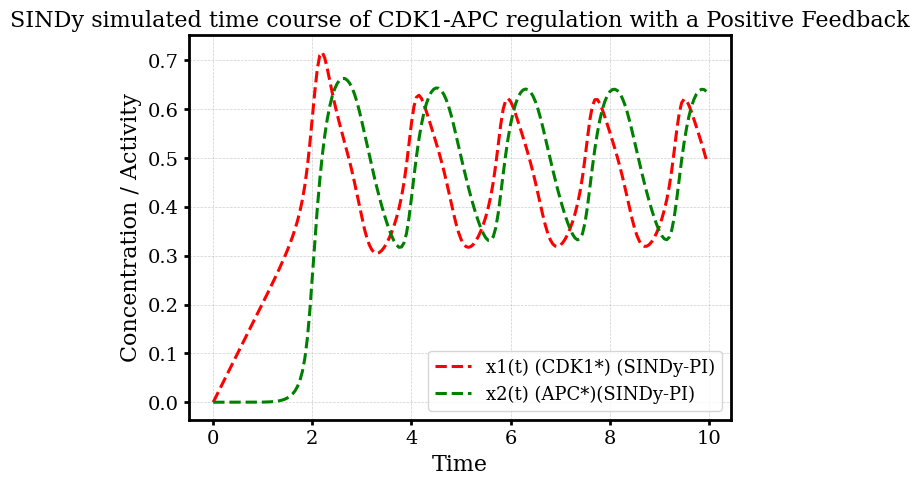

In [53]:
select_index_x1 = 5 # 5,6
select_index_x2 = 1 # 1

x1_dot_solution = final_model_x1_c2[select_index_x1]
x2_dot_solution = final_model_x2[select_index_x2]
# x2_dot_solution = final_model_x2_c2[select_index_x2]

##############################################################################
f_x1_dot = sp.lambdify((x1, x2), x1_dot_solution, 'numpy')
f_x2_dot = sp.lambdify((x1, x2), x2_dot_solution, 'numpy')

# Define the system for numerical integration
def identified_system(state, t):
    x1_val, x2_val = state  # Unpack state variables
    dx1_dt = f_x1_dot(x1_val, x2_val)
    dx2_dt = f_x2_dot(x1_val, x2_val)
    return [dx1_dt, dx2_dt]

# Initial conditions
z0 = [0.0, 0.0]
## Time points for the simulation
dt = 0.05
t0 = 0
tf= 50
t = np.arange(t0, tf + dt, dt)
solution = odeint(identified_system, z0, t)

print(f"\n==== MODEL : For x1: {select_index_x1} and for x2: {select_index_x2} ====")
print("x1_dot =", x1_dot_solution)
print("x2_dot =", x2_dot_solution)

## Time series plot
fig, ax = plt.subplots(figsize=(7, 5), dpi=100)
# Plot x1(t)
ax.plot(t[:200], solution[:200, 0], 'r--',  label='x1(t) (CDK1*) (SINDy-PI)')
# Plot x2(t)
ax.plot(t[:200], solution[:200, 1], 'g--', label='x2(t) (APC*)(SINDy-PI)')

# Labels, title, legend, grid
ax.grid(True, which='both', ls='--', lw=0.5)
ax.set_xlabel('Time')
ax.set_ylabel('Concentration / Activity')
ax.set_title('SINDy simulated time course of CDK1-APC regulation with a Positive Feedback')
# Thicken and color the axis spines
for spine in ax.spines.values():
    spine.set_linewidth(2)
    spine.set_edgecolor('k')

# Increase tick label size and weight
ax.tick_params(axis='both', which='major', labelsize=14, width=2)
ax.legend(loc='lower right')
plt.savefig("Plots_3/SINDy_TimeSeries_CDK1_APC_PF.pdf", bbox_inches="tight")
plt.show()


In [54]:
#####################################################################################################################################################
#                                                 V. Find the steady state and draw the network for the selected model
#
###################################################################################################################################################### Now, to find steady states
def ss_func_sindy(vars):
    x1_val, x2_val = vars
    dx1 = f_x1_dot(x1_val, x2_val)
    dx2 = f_x2_dot(x1_val, x2_val)
    return [dx1, dx2]
    
sindy_ss = find_steady_states(
    ss_func_sindy,
    num_vars=2,
    num_samples=500,
    tol=1e-8,
    domain=[(0, 1)]
)


print("Steady states found numerically:")
for ss in sindy_ss:
    x1_ss, x2_ss = ss
    print(f"[{x1_ss:.3f}, {x2_ss:.3f}]")


Steady states found numerically:
[0.464, 0.511]


In [55]:
# Define the Jacobian matrix of identified the system
# ------------------------------
f_SINDy = sp.Matrix([x1_dot_solution, x2_dot_solution])
J_SINDy = f_SINDy.jacobian(vars).applyfunc(lambda expr: expr.evalf(3))

In [56]:
J_SINDy_at_ss = []

for i, s in enumerate(sindy_ss, 1):
    val1, val2 = s  

    subs_dict = {x1: val1, x2: val2}
    J_SINDy_sub = J_SINDy.subs(subs_dict)
    eigs = J_SINDy_sub.eigenvals()
    J_SINDy_eval = J_SINDy_sub.evalf(3)
    J_SINDy_at_ss.append(J_SINDy_eval)

    # Print Jacobian
    print(f"\nJacobian at SS {i} = ({val1:.3f}, {val2:.3f}):")
    sp.pprint(J_SINDy_eval)

    # Print eigenvalues
    print(f"Eigenvalues at SS {i}:")
    for ev, mult in eigs.items():
        print(f"  {ev.evalf(3)}  (×{mult})")



Jacobian at SS 1 = (0.464, 0.511):
⎡3.66  -5.3 ⎤
⎢           ⎥
⎣5.68  -1.99⎦
Eigenvalues at SS 1:
  0.835 - 4.71*I  (×1)
  0.835 + 4.71*I  (×1)



Interaction network near SS 1 = (0.464, 0.511):


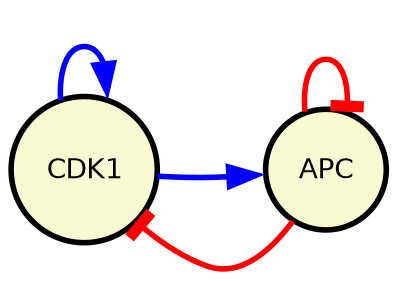

In [57]:
# ----------------------------------
#  Visualize interaction networks 
# ----------------------------------
try:
    Jacobians_np = [np.array(J_ss.tolist(), dtype=float) for J_ss in J_SINDy_at_ss]
    for i, (J_np, ss_point) in enumerate(zip(Jacobians_np, sindy_ss), 1):
        output_path = f"Plots_3/SINDy_CDK1_APC_PF_network_{i}"
        graph = draw_network(
            J_np,
            nodes=nodes,
            output_path=output_path,
            label_fontsize=10,
            graph_size='10,10',
            dpi=200
        )

        coord_str = ', '.join(f"{N(v, 3)}" for v in ss_point)
        print(f"\nInteraction network near SS {i} = ({coord_str}):")
        display(Image(filename=output_path + '.png'))

except Exception as e:
    print(f" Can't  Draw the Network: {e}")

In [58]:
##############################################################  END    ######################################################################